In [1]:
!pip install tensorflow_ranking fastdtw tensorflow_probability

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 150.4/150.4 kB 18.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.4/133.4 kB 33.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.7/6.7 MB 82.1 MB/s eta 0:00:00:00:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 56.4 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.0/153.0 kB 32.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 585.9/585.9 MB 3.5 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 440.7/440.7 kB 49.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 588.3/588.3 MB 3.4 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.0/6.0 MB 78.1 MB/s eta 0:00:00:00:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 89.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 439.2/439.2 kB 57.2 MB/s eta 0:00:00
  Created wheel for fa

In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt

import tensorflow as tf
import tensorflow_ranking as tfr
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Flatten, LSTM, Permute, Conv1D, MaxPooling1D, Conv2D, MaxPooling2D, Reshape, Dropout

from keras.regularizers import l2, l1
from keras.optimizers import Adam

import sklearn
from sklearn.decomposition import PCA
from sklearn.utils import class_weight
from sklearn.metrics import f1_score
from sklearn.utils import shuffle
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC

import pickle

from VAE import Sampling, VAE, get_auth_model_from_latent_space, get_decoder, get_encoder
from WAE import WAE, get_decoder as get_decoder_wae, get_encoder as get_encoder_wae
from scaler import CustomScaler

from visualise import *


2023-04-24 17:07:18.508209: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-24 17:07:19.562609: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-04-24 17:07:19.562719: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-04-24 17:07:19.562731: W tensorfl

In [2]:
from matplotlib.colors import Normalize

def normal_pdf(x, mean, var):
    return np.exp(-(x - mean)**2 / (2*var))


def plot_standard_devs(vae, data, labels, pca=None):
    # display a 2D plot showing the areas of impact of different points
    #z_mean, z_log_var, z = vae.encoder.predict(data)
    #z_std = tf.exp(0.5 * z_log_var)
    
    #if pca is None:
    #    pca = PCA(2)
    #    #z_pca = pca.fit_transform(z_mean)
    #    z_pca = z_mean[:,:2]
    #else:
    #    z_pca = pca.transform(z_mean)

    #z_std = pca.transform(z_std)
    #z_std = z_std[:,:2]

    # create 2 kernels
    m1 = (-1,-1)
    s1 = np.eye(2)
    k1 = multivariate_normal(mean=m1, cov=s1)

    m2 = (1,1)
    s2 = np.eye(2)
    k2 = multivariate_normal(mean=m2, cov=s2)

    # create a grid of (x,y) coordinates at which to evaluate the kernels
    xlim = (-3, 3)
    ylim = (-3, 3)
    xres = 100
    yres = 100

    x = np.linspace(xlim[0], xlim[1], xres)
    y = np.linspace(ylim[0], ylim[1], yres)
    xx, yy = np.meshgrid(x,y)

    # evaluate kernels at grid points
    #xxyy = np.c_[xx.ravel(), yy.ravel()]
    #full_array = np.full()
    #zz = k1.pdf(xxyy) + k2.pdf(xxyy)

    # reshape and plot image
    img = zz.reshape((xres,yres))
    plt.imshow(img); plt.show()

vae = None
#plot_standard_devs(vae, vae.scaler.transform(user_x)[:2], user_y[:2])
#plot_standard_devs(None, None, None)

In [3]:
tf.get_logger().setLevel('ERROR')

device_name = tf.test.gpu_device_name()
print(device_name)

file_name = "raw_with_maps" # or offsets_2

x_data = np.load(f"data/processed/x_{file_name}_filtered.npy")[:,:,[0,1,2,4,5,6]]
print(x_data.shape)

#from featurize import filter as _filter, ORDER, CUTOFF, FILTER_INDICES
#x_data = _filter(x_data, FILTER_INDICES, ORDER, CUTOFF)

y_user = np.load(f"data/processed/y_user_{file_name}.npy")
y_intent = np.load(f"data/processed/y_intent_{file_name}.npy").astype(int)
y_gesture = np.load(f"data/processed/y_gesture_type_{file_name}.npy")

train_gesture_map = np.load(f"data/processed/train_gesture_map_{file_name}.npy").astype(int)
test_gesture_map = np.load(f"data/processed/test_gesture_map_{file_name}.npy").astype(int)

###
np.random.seed(42)
kFold = sklearn.model_selection.StratifiedKFold(n_splits=10, shuffle=True)
val_map = next(kFold.split(x_data[train_gesture_map == 1], y_user[train_gesture_map == 1].argmax(axis=1) ))[1]
val_map_all = np.zeros(len(x_data[train_gesture_map == 1]))
val_map_all[val_map] = 1
val_map = val_map_all == 1



_map = (train_gesture_map == 1) #& ((y_user.argmax(axis=1) >= 14))

user_x = x_data[_map]
user_y = y_user.argmax(axis=1)[_map]

def show_visuals(vae, is_wae=False, user_x = user_x, user_y=user_y, top_5 = False):
    
    #plot_standard_devs(vae, vae.scaler.transform(user_x), user_y)
    
    plot_label_clusters(vae, vae.scaler.transform(user_x), user_y, is_wae=is_wae, top_5=top_5)
    visualise(vae, vae.scaler.transform(user_x), user_y, 10, is_wae=is_wae, top_5=top_5)
    plot_reconstructed_curves(vae, vae.scaler.transform(user_x), channel=2, is_wae=is_wae)

def stitch_histories(history1, history2):
    for key in history1:
        history1[key] += list(history2[key])
    return history1


/device:GPU:0
(34255, 200, 6)


In [4]:
#show_visuals(vae)

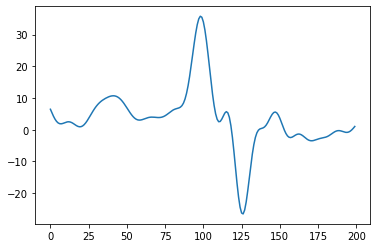

In [5]:
plt.plot(x_data[0,:,-1])

In [12]:
for alpha in [1, 1e-1, 1e-2, 1e-3, 1e-4, 1e-5, 1e-6]:
    beta = 1e-4
    latent_dim = 10

    encoder = get_encoder(latent_dim)
    decoder = get_decoder(latent_dim)
    auth = get_auth_model_from_latent_space(latent_dim)

    vae = VAE(encoder, decoder, None, auth, scale_included=True, use_stats=True, loss_func="LB_KEOGH_mod")
    vae.fit_scaler(x_data[(train_gesture_map==1)])
    vae.auth_on = True
    vae.beta = beta
    vae.gamma = 0.01
    vae.alpha = alpha

    train_data_x = vae.scaler.transform(x_data[train_gesture_map==1][~val_map])
    train_data_y = y_user[train_gesture_map==1][~val_map]

    val_data_x = vae.scaler.transform(x_data[train_gesture_map==1][val_map])
    val_data_y = y_user[train_gesture_map==1][val_map]


    early_stopping_callback = tf.keras.callbacks.EarlyStopping(monitor='val_total_loss', start_from_epoch=150,
                                                                patience=150, restore_best_weights=True)

    vae.beta = beta # 1e-4
    vae.compile(Adam(learning_rate=1e-4)) # 1e-5 takes ages
    history1 = vae.fit(train_data_x, train_data_y, epochs=2000, batch_size=128, verbose=1,
                      validation_data=(val_data_x, val_data_y),
                     callbacks=[early_stopping_callback])
    #show_visuals(vae)

    name = f"vae_lbkeogh_mod_stats_auth_on_alpha={alpha}_{latent_dim}"

    vae.save_model(f"Gen", name)

    with open(f"data/losses/Gen/{name}.pickle", "wb") as file:
        history = history1.history
        pickle.dump(history, file)

Epoch 1/2000
17/17 [==============================] - 21s 260ms/step - total_loss: -0.1004 - reconstruction_loss: 0.0149 - kl_loss: 0.0168 - classification_loss: 0.0000e+00 - feature_loss: 0.5534 - reencoding_loss: 0.0000e+00 - auth_loss: -0.1208 - val_total_loss: -0.0988 - val_reconstruction_loss: 0.0179 - val_kl_loss: 0.0393 - val_feature_loss: 0.4939 - val_auth_loss: -0.1216
Epoch 2/2000
17/17 [==============================] - 1s 54ms/step - total_loss: -0.1021 - reconstruction_loss: 0.0149 - kl_loss: 0.0789 - classification_loss: 0.0000e+00 - feature_loss: 0.4539 - reencoding_loss: 0.0000e+00 - auth_loss: -0.1215 - val_total_loss: -0.1021 - val_reconstruction_loss: 0.0180 - val_kl_loss: 0.1946 - val_feature_loss: 0.4448 - val_auth_loss: -0.1245
Epoch 3/2000
17/17 [==============================] - 1s 54ms/step - total_loss: -0.1031 - reconstruction_loss: 0.0149 - kl_loss: 0.3958 - classification_loss: 0.0000e+00 - feature_loss: 0.4208 - reencoding_loss: 0.0000e+00 - auth_loss: -0.

In [ ]:
for alpha in [1, 1e-1, 1e-2, 1e-3, 1e-4, 1e-5, 1e-6]:
    beta = 1e-4
    latent_dim = 10

    encoder = get_encoder_wae(latent_dim)
    decoder = get_decoder_wae(latent_dim)
    auth = get_auth_model_from_latent_space(latent_dim)

    vae = WAE(encoder, decoder, None, auth, scale_included=True, use_stats=True)
    vae.fit_scaler(x_data[(train_gesture_map==1)])
    vae.auth_on = True
    vae.beta = beta
    vae.gamma = 0.01
    vae.alpha = alpha

    train_data_x = vae.scaler.transform(x_data[train_gesture_map==1][~val_map])
    train_data_y = y_user[train_gesture_map==1][~val_map]

    val_data_x = vae.scaler.transform(x_data[train_gesture_map==1][val_map])
    val_data_y = y_user[train_gesture_map==1][val_map]


    early_stopping_callback = tf.keras.callbacks.EarlyStopping(monitor='val_total_loss', start_from_epoch=150,
                                                                patience=150, restore_best_weights=True)

    vae.beta = beta # 1e-4
    vae.compile(Adam(learning_rate=1e-4)) # 1e-5 takes ages
    history1 = vae.fit(train_data_x, train_data_y, epochs=2000, batch_size=128, verbose=1,
                      validation_data=(val_data_x, val_data_y),
                     callbacks=[early_stopping_callback])
    #show_visuals(vae)

    name = f"wae_lbkeogh_mod_stats_auth_on_alpha={alpha}_{latent_dim}"

    vae.save_model(f"Gen", name)

    with open(f"data/losses/Gen/{name}.pickle", "wb") as file:
        history = history1.history
        pickle.dump(history, file)

Epoch 1/2000
17/17 [==============================] - 24s 280ms/step - total_loss: 0.2131 - reconstruction_loss: 0.3272 - wae_loss: -3.9650 - classification_loss: 0.0000e+00 - feature_loss: 0.4056 - reencoding_loss: 0.0000e+00 - auth_loss: -0.1177 - val_total_loss: 0.2844 - val_reconstruction_loss: 0.3986 - val_wae_loss: -3.9739 - val_feature_loss: 0.3830 - val_auth_loss: -0.1177
Epoch 2/2000
17/17 [==============================] - 1s 55ms/step - total_loss: 0.2119 - reconstruction_loss: 0.3264 - wae_loss: -3.9513 - classification_loss: 0.0000e+00 - feature_loss: 0.3620 - reencoding_loss: 0.0000e+00 - auth_loss: -0.1178 - val_total_loss: 0.2812 - val_reconstruction_loss: 0.3958 - val_wae_loss: -3.9782 - val_feature_loss: 0.3755 - val_auth_loss: -0.1179
Epoch 3/2000
17/17 [==============================] - 1s 59ms/step - total_loss: 0.2082 - reconstruction_loss: 0.3230 - wae_loss: -4.0065 - classification_loss: 0.0000e+00 - feature_loss: 0.3606 - reencoding_loss: 0.0000e+00 - auth_loss

1/1 [==============================] - 0s 29ms/step


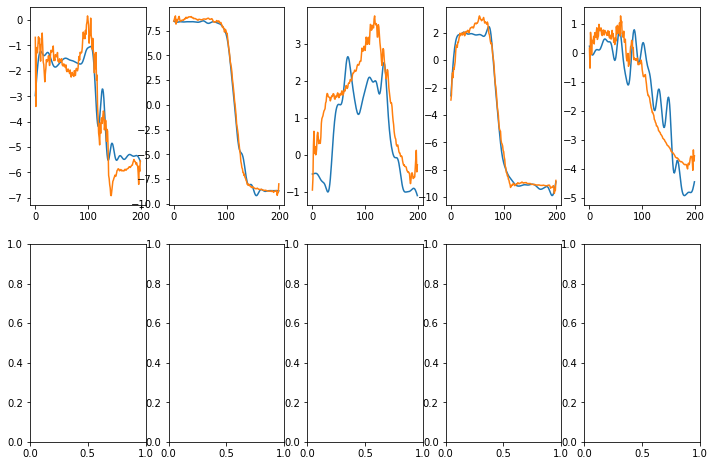

In [20]:
show_visuals(vae)

In [6]:
name = f"naive_autoencoder_mse_stats_v2_{latent_dim}"

vae.save_model(f"Gen", name)

with open(f"data/losses/Gen/{name}.pickle", "wb") as file:
    history = history1.history
    pickle.dump(history, file)

NameError: name 'history1' is not defined

75/75 [==============================] - 2s 12ms/step


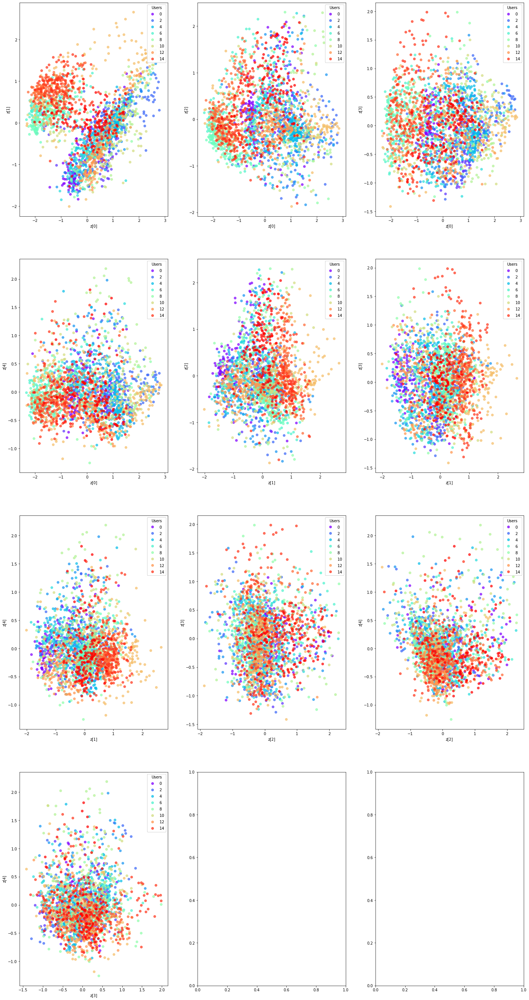

75/75 [==============================] - 1s 7ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


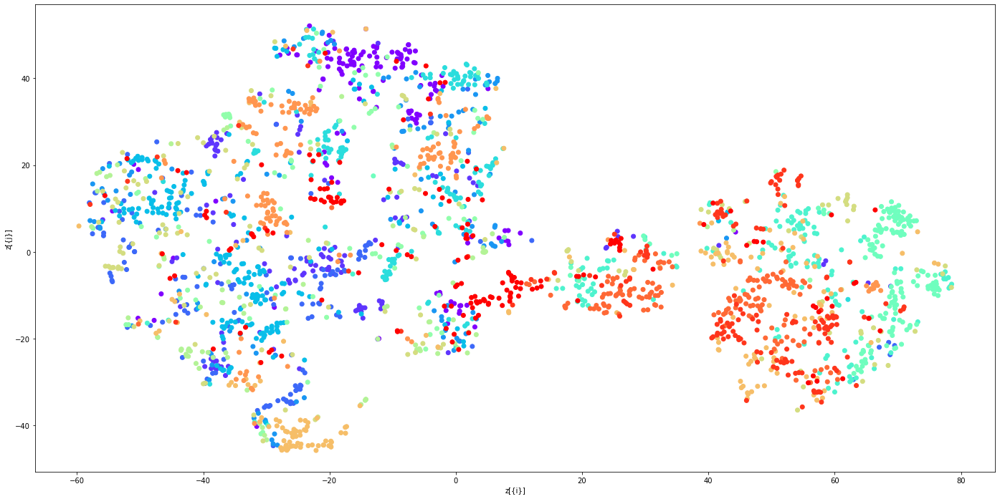

1/1 [==============================] - 0s 37ms/step


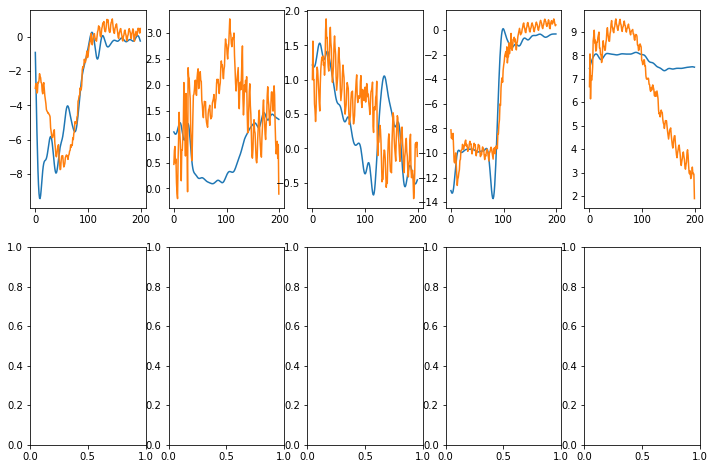

In [7]:
show_visuals(vae)

Epoch 1/2000
17/17 [==============================] - 28s 360ms/step - total_loss: 0.3157 - reconstruction_loss: 0.3127 - wae_loss: -3.9045 - classification_loss: 0.0000e+00 - feature_loss: 0.3402 - reencoding_loss: 0.0000e+00 - auth_loss: 0.0000e+00 - val_total_loss: 0.3645 - val_reconstruction_loss: 0.3616 - val_wae_loss: -3.9311 - val_feature_loss: 0.3266 - val_auth_loss: 0.0000e+00
Epoch 2/2000
17/17 [==============================] - 1s 44ms/step - total_loss: 0.3077 - reconstruction_loss: 0.3049 - wae_loss: -3.9790 - classification_loss: 0.0000e+00 - feature_loss: 0.3174 - reencoding_loss: 0.0000e+00 - auth_loss: 0.0000e+00 - val_total_loss: 0.3419 - val_reconstruction_loss: 0.3390 - val_wae_loss: -4.0852 - val_feature_loss: 0.3319 - val_auth_loss: 0.0000e+00
Epoch 3/2000
17/17 [==============================] - 1s 48ms/step - total_loss: 0.2877 - reconstruction_loss: 0.2848 - wae_loss: -4.1528 - classification_loss: 0.0000e+00 - feature_loss: 0.3347 - reencoding_loss: 0.0000e+00

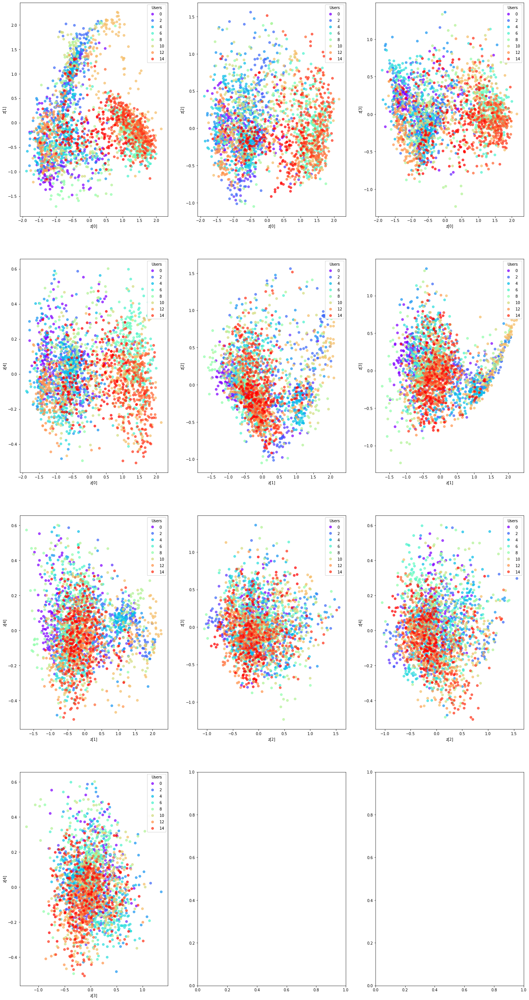

75/75 [==============================] - 0s 6ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


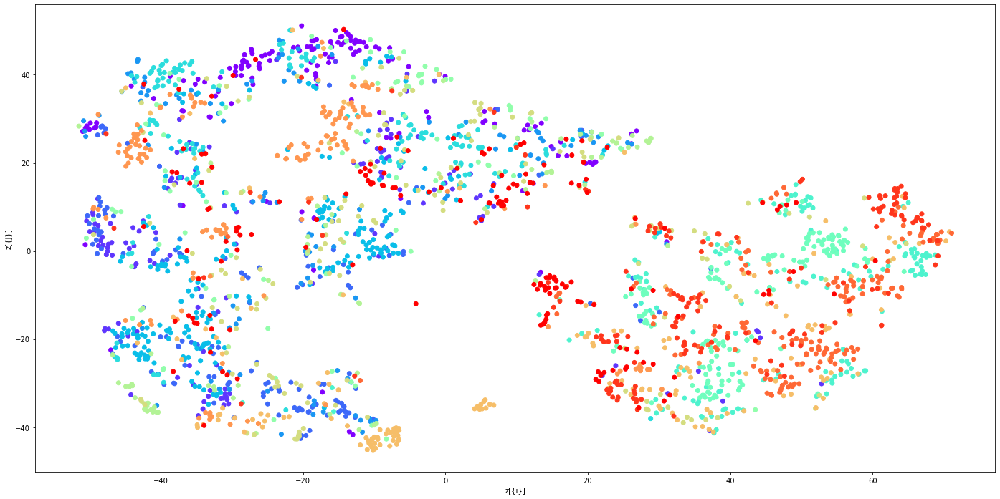

1/1 [==============================] - 0s 34ms/step


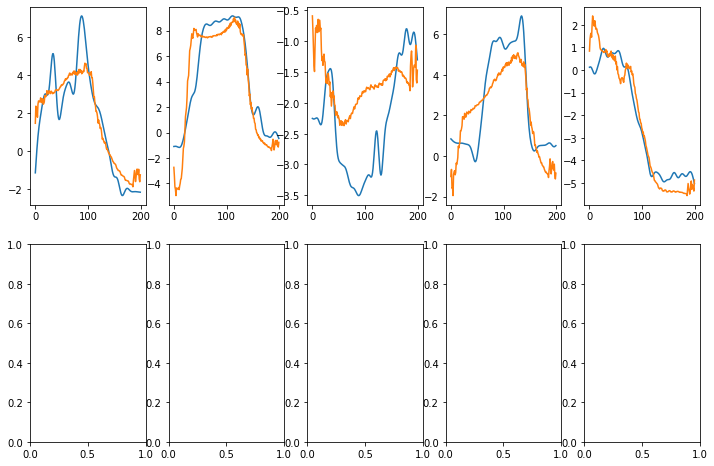

Epoch 1/2000
17/17 [==============================] - 23s 316ms/step - total_loss: 0.3166 - reconstruction_loss: 0.3133 - wae_loss: -3.9756 - classification_loss: 0.0000e+00 - feature_loss: 0.3317 - reencoding_loss: 0.0000e+00 - auth_loss: 0.0000e+00 - val_total_loss: 0.3674 - val_reconstruction_loss: 0.3644 - val_wae_loss: -4.1909 - val_feature_loss: 0.2969 - val_auth_loss: 0.0000e+00
Epoch 2/2000
17/17 [==============================] - 1s 47ms/step - total_loss: 0.3132 - reconstruction_loss: 0.3102 - wae_loss: -3.9601 - classification_loss: 0.0000e+00 - feature_loss: 0.3022 - reencoding_loss: 0.0000e+00 - auth_loss: 0.0000e+00 - val_total_loss: 0.3624 - val_reconstruction_loss: 0.3593 - val_wae_loss: -4.1127 - val_feature_loss: 0.3120 - val_auth_loss: 0.0000e+00
Epoch 3/2000
17/17 [==============================] - 1s 46ms/step - total_loss: 0.3024 - reconstruction_loss: 0.2992 - wae_loss: -4.0562 - classification_loss: 0.0000e+00 - feature_loss: 0.3298 - reencoding_loss: 0.0000e+00

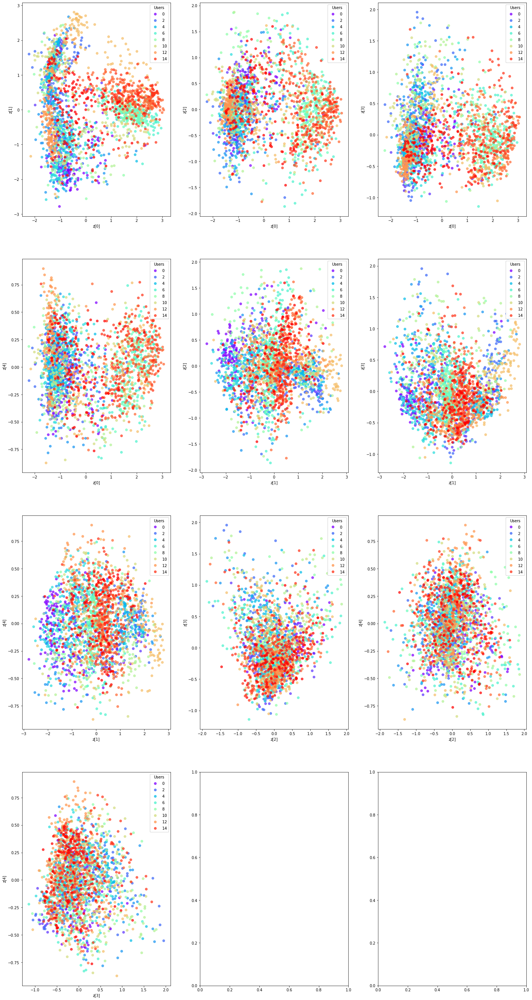

75/75 [==============================] - 0s 6ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


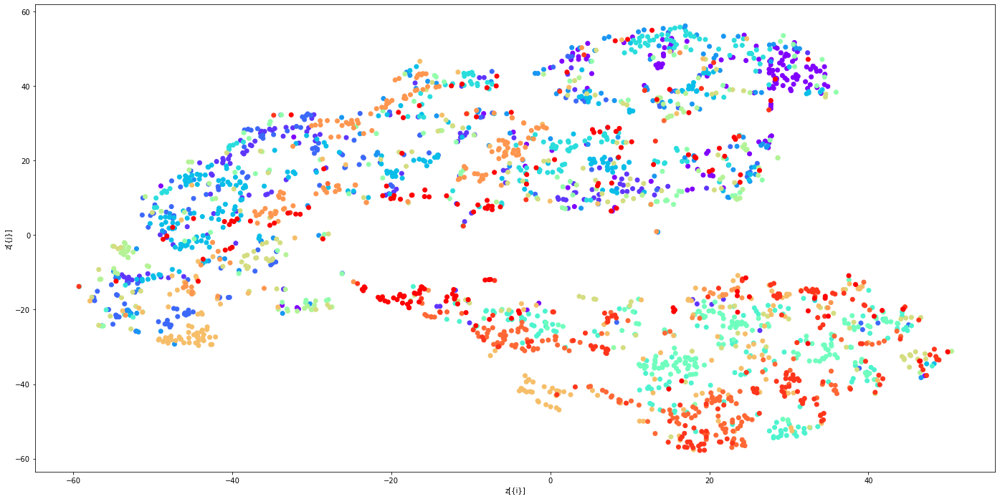

1/1 [==============================] - 0s 26ms/step


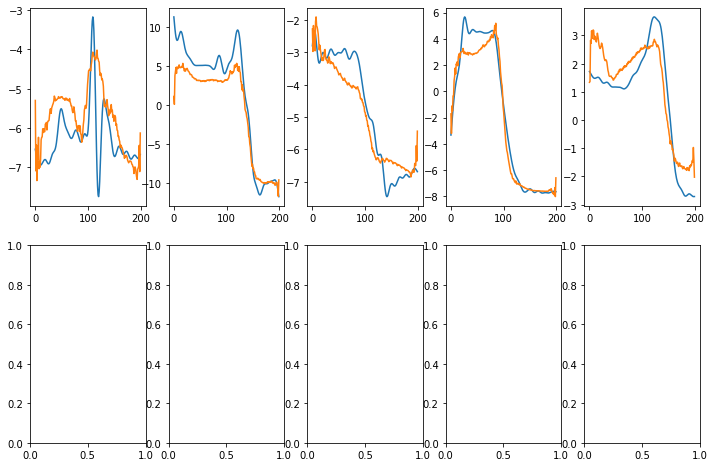

Epoch 1/2000
17/17 [==============================] - 22s 261ms/step - total_loss: 0.3170 - reconstruction_loss: 0.3137 - wae_loss: -3.9855 - classification_loss: 0.0000e+00 - feature_loss: 0.3256 - reencoding_loss: 0.0000e+00 - auth_loss: 0.0000e+00 - val_total_loss: 0.3680 - val_reconstruction_loss: 0.3653 - val_wae_loss: -4.0598 - val_feature_loss: 0.2777 - val_auth_loss: 0.0000e+00
Epoch 2/2000
17/17 [==============================] - 1s 49ms/step - total_loss: 0.3161 - reconstruction_loss: 0.3134 - wae_loss: -3.9693 - classification_loss: 0.0000e+00 - feature_loss: 0.2621 - reencoding_loss: 0.0000e+00 - auth_loss: 0.0000e+00 - val_total_loss: 0.3676 - val_reconstruction_loss: 0.3649 - val_wae_loss: -4.0255 - val_feature_loss: 0.2665 - val_auth_loss: 0.0000e+00
Epoch 3/2000
17/17 [==============================] - 1s 50ms/step - total_loss: 0.3158 - reconstruction_loss: 0.3132 - wae_loss: -3.9781 - classification_loss: 0.0000e+00 - feature_loss: 0.2544 - reencoding_loss: 0.0000e+00

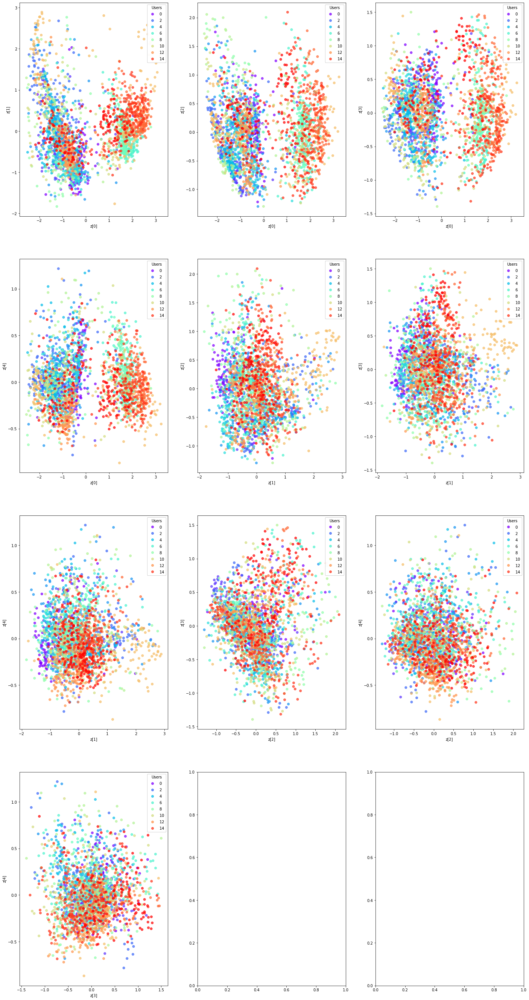

75/75 [==============================] - 1s 8ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


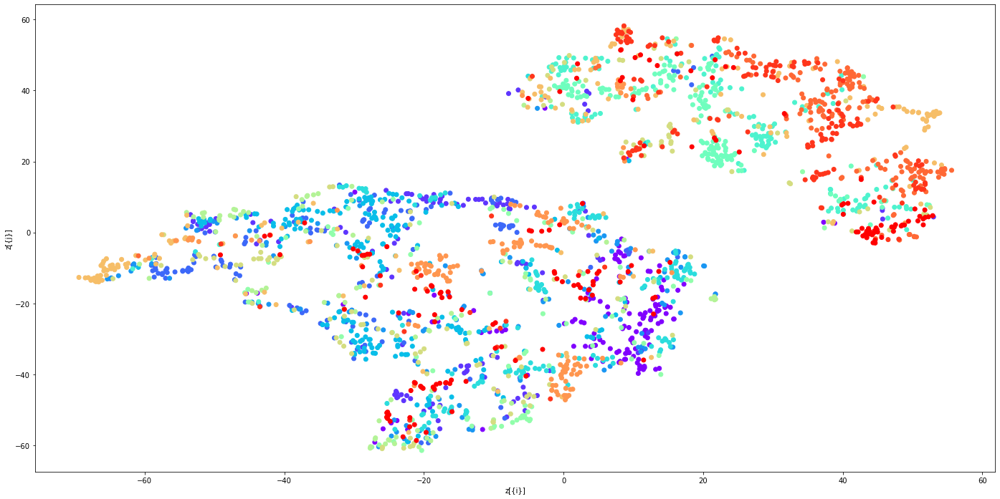

1/1 [==============================] - 0s 26ms/step


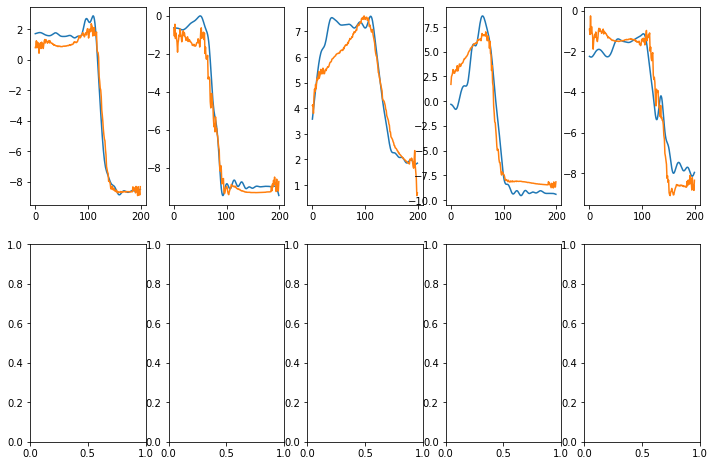

In [7]:
for beta in [ 1e-4, 1e-5, 1e-6]: # 1, 1e-1, 1e-2, 1e-3,
    for latent_dim in [10]: # , 30, 10, 100]: # 500, 50, 40, 30, 20, 10

        encoder = get_encoder_wae(latent_dim)
        decoder = get_decoder_wae(latent_dim)
        #auth = get_auth_model_from_latent_space(latent_dim)

        vae = WAE(encoder, decoder, None, None, scale_included=True, use_stats=True) # , loss_func="LB_KEOGH_mod")
        vae.fit_scaler(x_data[(y_intent==0)])
        vae.gamma = 0.01
        vae.auth_on = False

    #    show_visuals(vae)
        train_data_x = vae.scaler.transform(x_data[train_gesture_map==1][~val_map])
        train_data_y = y_user[train_gesture_map==1][~val_map]

        val_data_x = vae.scaler.transform(x_data[train_gesture_map==1][val_map])
        val_data_y = y_user[train_gesture_map==1][val_map]


        early_stopping_callback = tf.keras.callbacks.EarlyStopping(monitor='val_total_loss', start_from_epoch=150,
                                                                    patience=150, restore_best_weights=True)

        vae.beta = beta # 1e-4
        vae.compile(Adam(learning_rate=1e-4)) # 1e-5 takes ages
        history1 = vae.fit(train_data_x, train_data_y, epochs=2000, batch_size=128, verbose=1,
                          validation_data=(val_data_x, val_data_y),
                         callbacks=[early_stopping_callback])
        show_visuals(vae, is_wae=True)

        name = f"wae_lbkeogh_mod_stats_beta={beta}_{latent_dim}"

        vae.save_model(f"Gen", name)

        with open(f"data/losses/Gen/{name}.pickle", "wb") as file:
            history = history1.history
            pickle.dump(history, file)

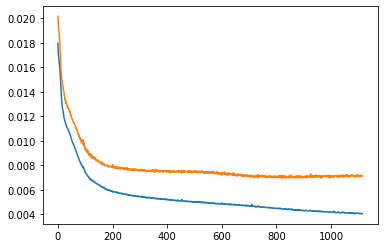

1/1 [==============================] - 0s 30ms/step


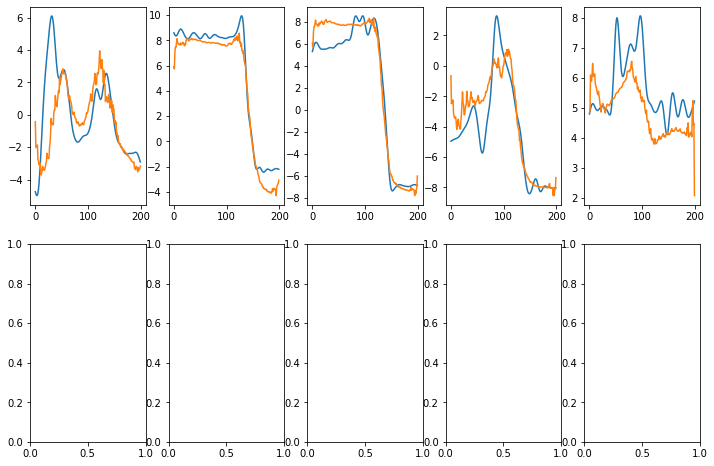

In [7]:
losses = history

plt.plot(losses["total_loss"])
plt.plot(losses["val_total_loss"])
plt.show()

show_visuals(vae)

0.0001
Epoch 1/10
260/260 [==============================] - 26s 35ms/step - total_loss: 0.1918 - reconstruction_loss: 0.1918 - wae_loss: 0.0000e+00 - classification_loss: 0.0000e+00 - feature_loss: 0.0000e+00 - reencoding_loss: 0.0000e+00 - auth_loss: 0.0000e+00
Epoch 2/10
260/260 [==============================] - 9s 33ms/step - total_loss: 0.1231 - reconstruction_loss: 0.1231 - wae_loss: 0.0000e+00 - classification_loss: 0.0000e+00 - feature_loss: 0.0000e+00 - reencoding_loss: 0.0000e+00 - auth_loss: 0.0000e+00
Epoch 3/10
260/260 [==============================] - 10s 37ms/step - total_loss: 0.1137 - reconstruction_loss: 0.1137 - wae_loss: 0.0000e+00 - classification_loss: 0.0000e+00 - feature_loss: 0.0000e+00 - reencoding_loss: 0.0000e+00 - auth_loss: 0.0000e+00
Epoch 4/10
260/260 [==============================] - 10s 40ms/step - total_loss: 0.1112 - reconstruction_loss: 0.1112 - wae_loss: 0.0000e+00 - classification_loss: 0.0000e+00 - feature_loss: 0.0000e+00 - reencoding_loss: 0

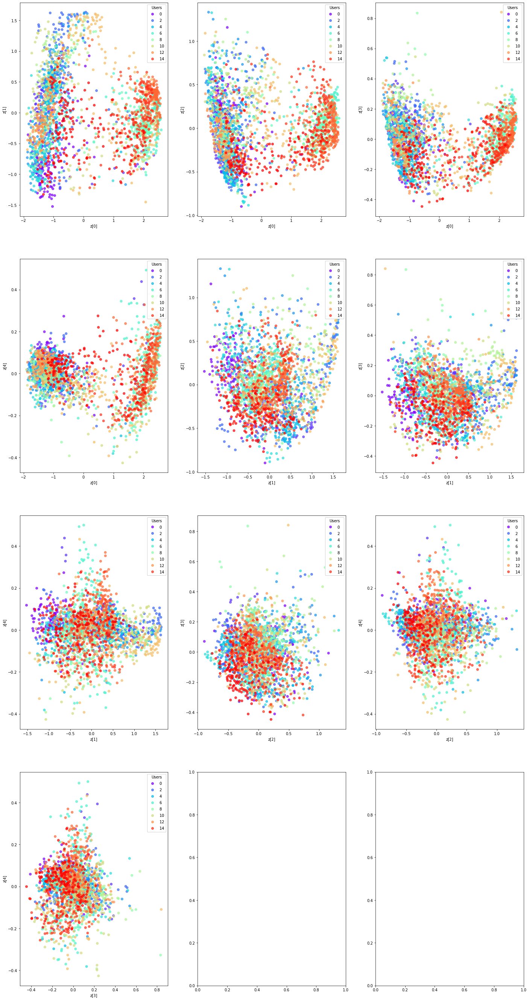

75/75 [==============================] - 1s 8ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


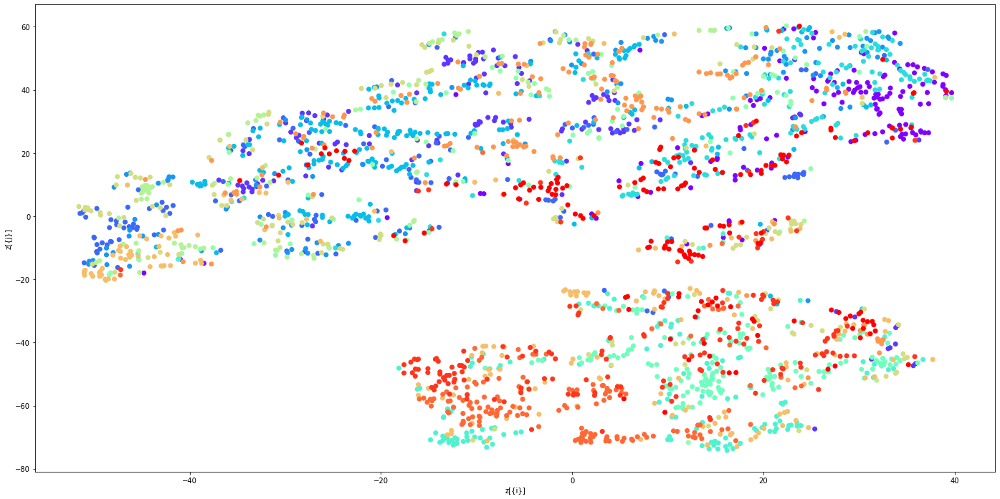

1/1 [==============================] - 0s 24ms/step


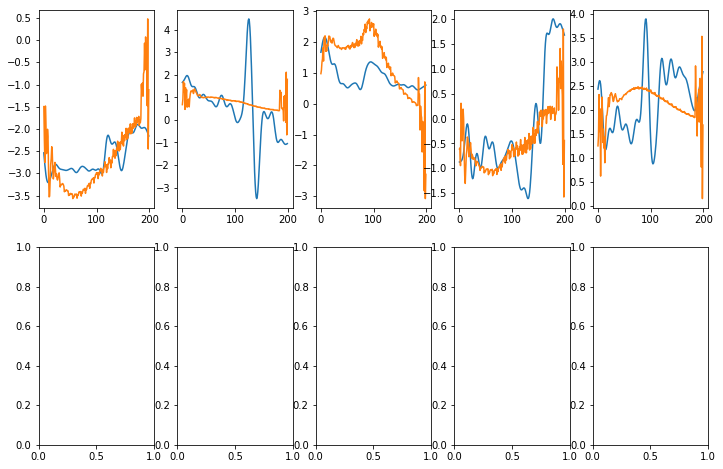

Epoch 1/2000
68/68 [==============================] - 21s 96ms/step - total_loss: 0.0811 - reconstruction_loss: 0.0932 - wae_loss: -4.3308 - classification_loss: 0.0000e+00 - feature_loss: 0.0000e+00 - reencoding_loss: 0.0000e+00 - auth_loss: -0.1168 - val_total_loss: 0.0989 - val_reconstruction_loss: 0.1109 - val_wae_loss: -4.0737 - val_feature_loss: 0.0000e+00 - val_auth_loss: -0.1164
Epoch 2/2000
68/68 [==============================] - 3s 39ms/step - total_loss: 0.0768 - reconstruction_loss: 0.0890 - wae_loss: -4.3328 - classification_loss: 0.0000e+00 - feature_loss: 0.0000e+00 - reencoding_loss: 0.0000e+00 - auth_loss: -0.1173 - val_total_loss: 0.0951 - val_reconstruction_loss: 0.1072 - val_wae_loss: -4.3760 - val_feature_loss: 0.0000e+00 - val_auth_loss: -0.1168
Epoch 3/2000
68/68 [==============================] - 2s 36ms/step - total_loss: 0.0741 - reconstruction_loss: 0.0863 - wae_loss: -4.3261 - classification_loss: 0.0000e+00 - feature_loss: 0.0000e+00 - reencoding_loss: 0.0

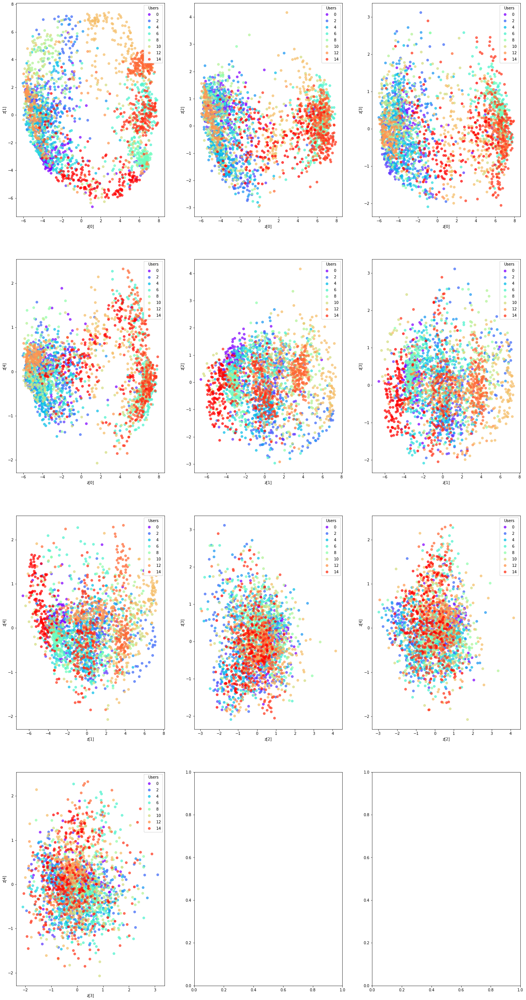

75/75 [==============================] - 0s 5ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


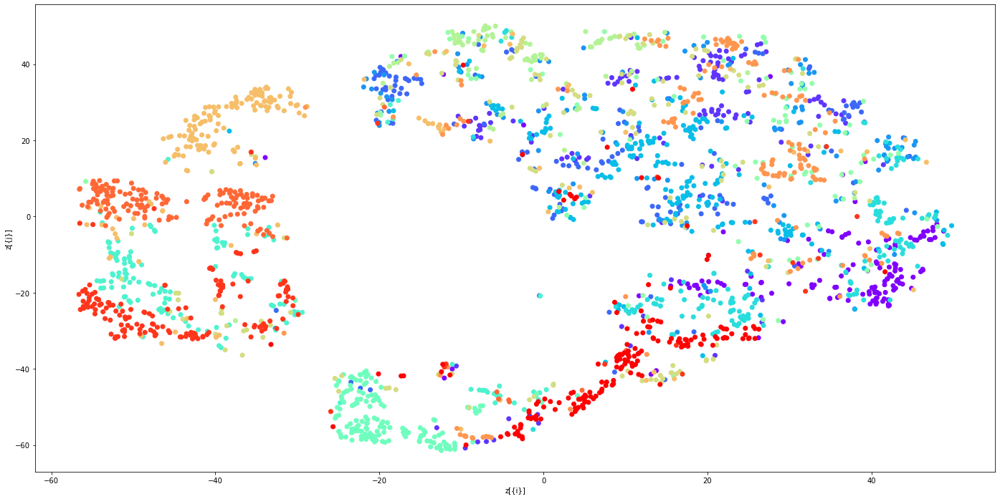

1/1 [==============================] - 0s 29ms/step


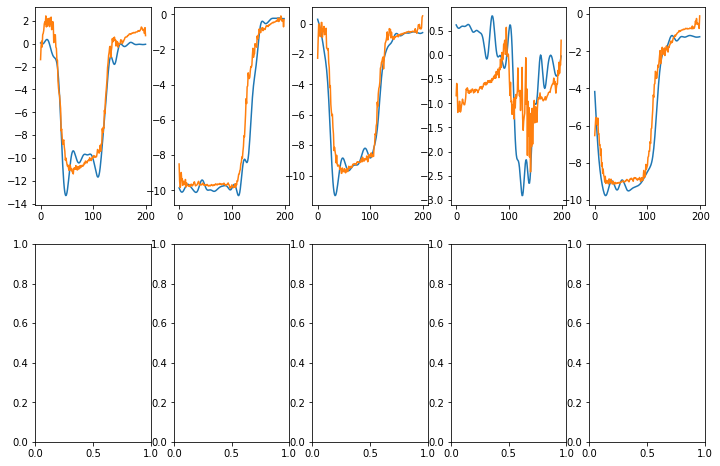

In [5]:
for beta in [1e-4]: #:[1e-3, 1e-4, 1e-5, 1, 1e-1, 1e-2, 1e-6]:
    print(beta)
    latent_dim = 10
    encoder = get_encoder_wae(latent_dim)
    decoder = get_decoder_wae(latent_dim)
    auth = get_auth_model_from_latent_space(latent_dim)

    wae = WAE(encoder, decoder, None, auth, scale_included=True, use_stats=False)
    wae.fit_scaler(x_data[(y_intent==0)])
    wae.auth_on = False
    wae.wae_loss_on = False
    wae.alpha = 0.1
    
    
    initial_map = (train_gesture_map==1) | (y_intent == 0)
    train_data = wae.scaler.transform(x_data[initial_map])
    opt = keras.optimizers.Adam()
    
    wae.compile(Adam(learning_rate=1e-4))
    history_1 = wae.fit(train_data, y_user[initial_map], epochs=10, batch_size=128)
    
    show_visuals(wae, True)
    
    train_data_x = wae.scaler.transform(x_data[train_gesture_map==1][~val_map])
    train_data_y = y_user[train_gesture_map==1][~val_map]

    val_data_x = wae.scaler.transform(x_data[train_gesture_map==1][val_map])
    val_data_y = y_user[train_gesture_map==1][val_map]


    early_stopping_callback = tf.keras.callbacks.EarlyStopping(monitor='val_total_loss', start_from_epoch=150,
                                                                patience=150, restore_best_weights=True)

    wae.beta = beta
    wae.auth_on = True
    wae.wae_loss_on = True
    wae.compile(Adam(learning_rate=1e-4)) # 1e-5 takes ages
    history2 = wae.fit(train_data_x, train_data_y, epochs=2000, batch_size=32, verbose=1,
                      validation_data=(val_data_x, val_data_y),
                     callbacks=[early_stopping_callback])
    show_visuals(wae, True)

    name = f"wae_lbkeogh_mod_beta={beta}_lsauth_{latent_dim}"

    wae.save_model(f"Gen", name)

    with open(f"data/losses/Gen/{name}.pickle", "wb") as file:
        history = history2.history
        pickle.dump(history, file)

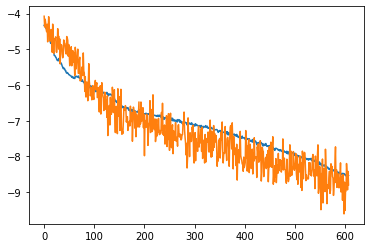

In [33]:
losses = history

plt.plot(losses["wae_loss"])
plt.plot(losses["val_wae_loss"])
plt.show()

#show_visuals(wae,True,  top_5=True) # wae.scaler.inverse_transform(val_data_x), val_data_y.argmax(axis=1),

In [ ]:
first_time = True
for latent_dim in [10]: # , 30, 10, 100]: # 500, 50, 40, 30, 20, 10
    
    """
    if first_time:
        encoder = get_encoder(latent_dim)
        decoder = get_decoder(latent_dim)
        #auth = get_auth_model_from_latent_space(latent_dim)

        vae = VAE(encoder, decoder, None, None, scale_included=True, loss_func="MSE")
        vae.fit_scaler(x_data[(y_intent==0)])
        vae.auth_on = False
        
        show_visuals(vae)

        initial_map = (train_gesture_map==1) | (y_intent == 0)
        train_data = vae.scaler.transform(x_data[initial_map])

        print("Fitting basic")

        vae.beta = 1e-4
        vae.compile(Adam())
        history_1 = vae.fit(train_data, y_user[initial_map], epochs=100, batch_size=128, verbose=1)
        vae.save_model(f"Gen", f"all_users_filtered_basic_reconstruction_mse_{latent_dim}")
    """
    
    specific_map = (train_gesture_map==1) 
    vae = VAE(None, None, None, None, loss_func="LB_KEOGH")
    vae.load_model(f"Gen", f"all_users_filtered_basic_reconstruction_mse_{latent_dim}")

    #show_visuals(vae)
    
    beta = 1e-4
    vae.beta = beta
    vae.alpha = 0.01
    vae.auth_on = False

    vae.compile(Adam())

    train_data = vae.scaler.transform(x_data[specific_map])
    
    history_2 = vae.fit(train_data, y_user[specific_map], epochs=2000, batch_size=128, verbose=1)

    history = history_1.history
    history = stitch_histories(history, history_2.history)


    """
    beta = 1e-2
    vae.beta = beta
    vae.alpha = 0.5
    vae.auth_on = True
    print("Fitting specific - higher auth")
    
    vae.fit(train_data, y_user[specific_map], epochs=1000, batch_size=128, verbose=1)
    
    show_visuals(vae)
    """
    
    name = f"all_users_filtered_specifically_trained_mse_{latent_dim}"
    
    vae.save_model(f"Gen", f"all_users_filtered_specifically_trained_mse_{latent_dim}")
    
    with open(f"data/losses/Gen/{name}.pickle", "wb") as file:
        pickle.dump(history, file)

In [7]:

print(history.keys())
plt.plot(history["loss"])
#plt.yscale("log")

AttributeError: 'History' object has no attribute 'keys'

In [ ]:
show_visuals(vae)

z_pca = vae.encoder(vae.scaler.transform(x_data[train_gesture_map == 1]))[2]

labels = y_user.argmax(axis=1)[train_gesture_map == 1]

print(z_pca.shape)
    
comps = 5

pair_set = [(i,j) for i in range(comps) for j in range(i+1,comps)]

fig, ax = plt.subplots(1 + len(pair_set)//3,3, figsize=(24,48))

for ix, (i,j) in enumerate(pair_set):
    scatter = ax[divmod(ix, 3)].scatter(z_pca[:, i], z_pca[:, j], c=labels, alpha=0.7, cmap = "rainbow")
    ax[divmod(ix, 3)].set_xlabel(f"z[{i}]")
    ax[divmod(ix, 3)].set_ylabel(f"z[{j}]")
    legend = ax[divmod(ix, 3)].legend(*scatter.legend_elements(),
                loc="upper right", title="Users")
    ax[divmod(ix, 3)].add_artist(legend)
#plt.colorbar()

plt.show()
a = 1/0
user_pred = vae.auth(enc)
user_labels = y_user[test_gesture_map == 1]
tf.keras.losses.CategoricalCrossentropy()(user_labels, user_pred)

relevant_pred = user_pred.numpy() * user_labels

relevant_pred = np.mean(relevant_pred, axis=1) * 6

for auth_user in range(6):

    display(sum((relevant_pred > user_pred.numpy()[:,auth_user])[y_user.argmax(axis=1)[test_gesture_map == 1] != auth_user]) / sum(test_gesture_map))

sum(user_pred.numpy().argmax(axis=1) == user_labels.argmax(axis=1)) / sum(test_gesture_map)

In [ ]:
beta = 1e-3
vae.beta = beta
vae.alpha = 0.5
vae.auth_on = True
print("Fitting specific - higher auth")

vae.compile(Adam())
    
vae.fit(train_data, y_user[specific_map], epochs=20, batch_size=128, verbose=1)
show_visuals(vae)

In [ ]:
!pip install tensorflow_ranking tensorflow_addons tensorflow_probability

In [ ]:
def show_visuals(vae):
    
    
    latent_space_means, latent_space_stds, latent_space = vae.encoder(vae.scaler.transform(user_x[:5]))
    print(latent_space_means[:,0].shape)
    plt.scatter(latent_space_means[:,0], latent_space_means[:,1], c=range(5), label="means")
    plt.scatter(latent_space[:,0], latent_space[:,1], label="sampled",c=range(5), s=10)
    
    print(latent_space_stds)

    plt.legend()
    
    plot_label_clusters(vae, vae.scaler.transform(user_x), user_y)
    visualise(vae, vae.scaler.transform(user_x), user_y, 10)
    plot_reconstructed_curves(vae, vae.scaler.transform(user_x), channel=7)

In [ ]:
latent_dim = 10
vae = VAE(None, None, None, None)
vae.load_model(f"all_users", f"high_beta_specifically_trained_{latent_dim}")

specific_map = train_gesture_map == 1

vae.beta = 1e-2
vae.compile(Adam())
train_data = vae.scaler.transform(x_data[specific_map])

for i in range(10):
    print(i)
    vae.fit(train_data, y_user[specific_map], epochs=50, batch_size=128, verbose=1)
    show_visuals(vae)

In [ ]:
latent_dim = 10



vae = VAE(None, None, None, None)
vae.load_model(f"all_users", f"high_beta_specifically_trained_{latent_dim}")

# TODO - save rest of variables in a state_dict



show_visuals(vae)